In [1]:
import numpy as np
from numba import jit
import cmath
import matplotlib.pyplot as plt

In [2]:
import ICN 
import EIM
import TDM
from bpm_initial_conditions import GaussianBeam_BPM_FFT2D

In [3]:
'''set up waveguide geometry as defined in Yamauchi'''
nair = 1.0
ngl = 3.44
ns = 3.0
npec = 9j

#units in micron
Ya = 4.0
Ys = 3.0
Xs = 2.5
W = 3.0
H =  1.0
T = 0.5
XPEC = 0.5
YPEC = 0.5

#define computational domain size
LX = W + 2*Xs + 2*XPEC
Lx = W + 2*Xs 
LY = Ya + H + Ys + 2*YPEC
Ly = Ya + H + Ys 

NX = 100
NY = 100

xc = int(NX/2)
yc = int(NY/2)+NY/16
ycc = int(NY/2)

dx = LX/NX
dy = LY/NY

#locations in grid space
w = int(W/dx)
h = int(H/dy)
ys = int(Ys/dy)
t = int(T/dy)
lx = int(Lx/dx)
ly = int(Ly/dy)
lX = int(LX/dx)
lY = int(LY/dy)

In [8]:
"""build waveguide geometry class object"""
waveguide = EIM.geom(NX,NY)

In [9]:
"""Add waveguide structure"""
waveguide.block(xc,yc,w,h,ngl) #rib
waveguide.block(xc,int(yc-h/2),lx,t,ngl) #t
waveguide.block(xc,int(yc-h/2-ys/2),lx,ys,ns) #substrate

In [7]:
'''Add PEC'''
waveguide.block(xc,2,lX,4,npec) #bottom
waveguide.block(xc,NX-2,lX,4,npec) #top
waveguide.block(2,ycc,4,lY,npec) #left
waveguide.block(NX-2,ycc,4,lY,npec) #top

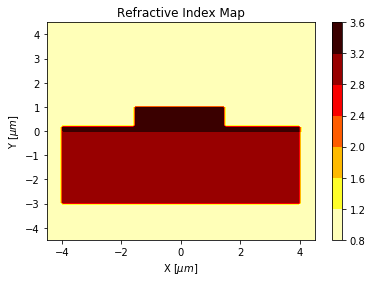

In [10]:
waveguide.plot(LX,LY,"hot_r",False,True)

In [41]:
"""Propagation Information"""
LZ = 10
dz = 0.005
NZ = LZ/dz
dz = 0.005j

w = 0.3
lamb = 1.55
z = 0

k0,kx,zR,stps,cx,E0 = GaussianBeam_BPM_FFT2D(lamb,w,LX,LZ,NX,dz,z)

kr = k0

n = waveguide.n
NZ

2000.0

In [31]:
#create a field object
E = ICN.Field(NX,NY,dx,dy,dz,kr,k0)

In [32]:
#set intial field, x polarized
E.initial_field(E0,True)

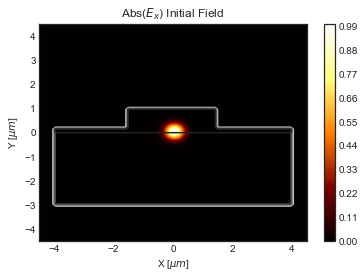

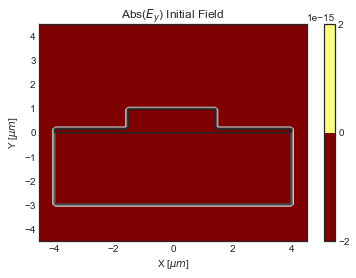

In [33]:
plt.style.use('seaborn-white')

waveguide.plot(LX,LY,'binary',True,False)
nX = np.linspace(-LX/2,LX/2,NX)
nY = np.linspace(-LY/2,LY/2,NY)
plt.contourf(nX,nY,np.abs(E.data2d[0]),100,cmap = "afmhot")
plt.colorbar()
plt.xlabel("X [$\mu m$]")
plt.ylabel("Y [$\mu m$]")

plt.title("Abs($E_x$) Initial Field")
plt.show()

waveguide.plot(LX,LY,'binary',True,False)
nX = np.linspace(-LX/2,LX/2,NX)
nY = np.linspace(-LY/2,LY/2,NY)
plt.contourf(nX,nY,np.abs(E.data2d[1]),100,cmap = "afmhot")
plt.colorbar()
plt.xlabel("X [$\mu m$]")
plt.ylabel("Y [$\mu m$]")

plt.title("Abs($E_y$) Initial Field")
plt.show()

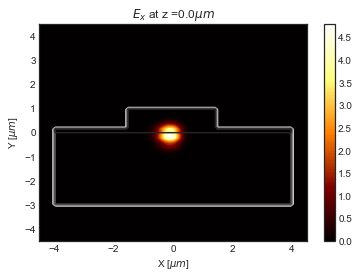

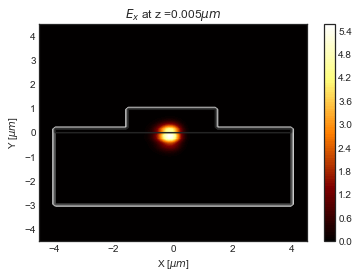

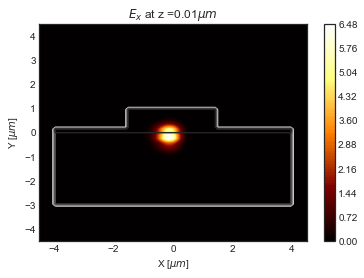

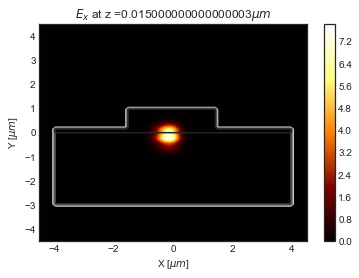

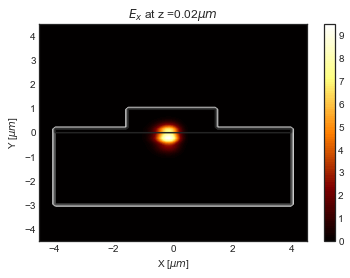

...

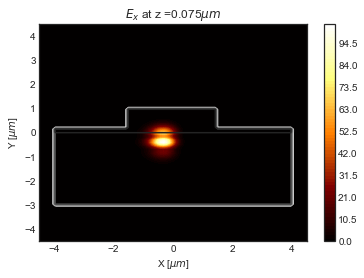

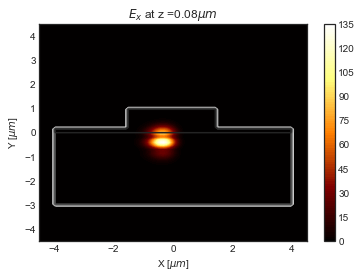

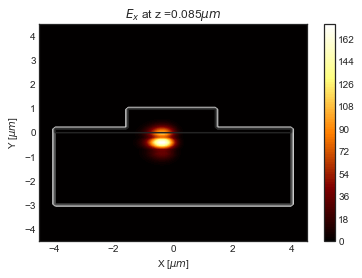

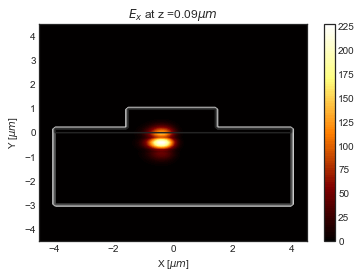

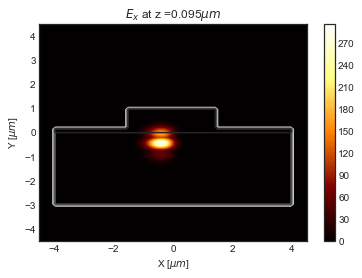

In [37]:
j = int(0)
for i in range(int(NZ)):
    E.step(n)
    E.ADI_BPM_solver(0,n)
    E.ADI_BPM_solver(1,n)
    
    j += 1
    if j ==1:
        waveguide.plot(LX,LY,'binary',True,False)
        nX = np.linspace(-LX/2,LX/2,NX)
        nY = np.linspace(-LY/2,LY/2,NY)
        plt.contourf(nX,nY,np.abs(E.data2d[0]),100,cmap = "afmhot")
        plt.colorbar()
        plt.title("$E_x$ at z ="+ str(LZ* i /NZ ) + "$\mu m $")
        plt.show()
        j=0
        



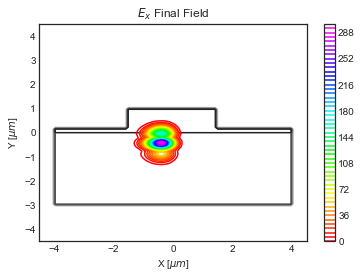

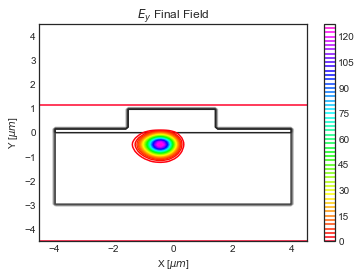

In [38]:
plt.style.use('seaborn-white')

waveguide.plot(LX,LY,'binary',True,False)
nX = np.linspace(-LX/2,LX/2,NX)
nY = np.linspace(-LY/2,LY/2,NY)
plt.contour(nX,nY,np.abs(E.data2d[7]),50,cmap = "gist_rainbow")
plt.colorbar()
plt.xlabel("X [$\mu m$]")
plt.ylabel("Y [$\mu m$]")

plt.title("$E_x$ Final Field")
plt.show()

waveguide.plot(LX,LY,'binary',True,False)
nX = np.linspace(-LX/2,LX/2,NX)
nY = np.linspace(-LY/2,LY/2,NY)
plt.contour(nX,nY,np.abs(E.data2d[8]),50,cmap = "gist_rainbow")
plt.colorbar()
plt.xlabel("X [$\mu m$]")
plt.ylabel("Y [$\mu m$]")

plt.title("$E_y$ Final Field")
plt.show()

In [39]:
#Non-vectorial BPM
E = ICN.Field(NX,NY,dx,dy,dz,kr,k0)
#set intial field, x polarized
E.initial_field(E0,True)

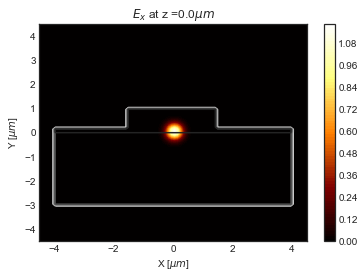

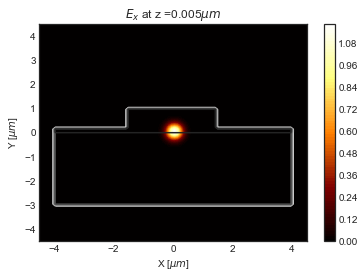

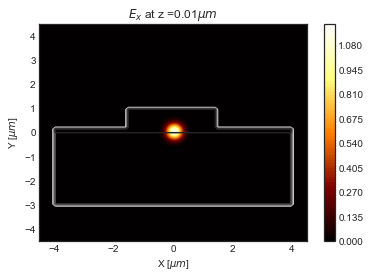

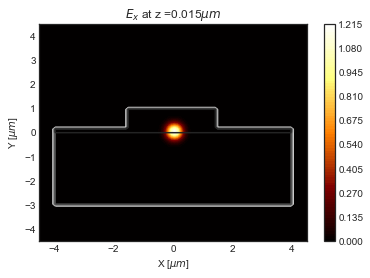

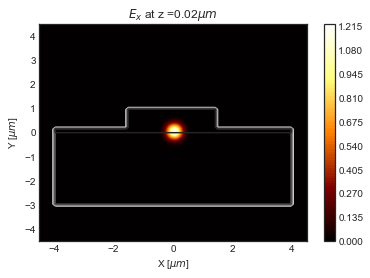

...

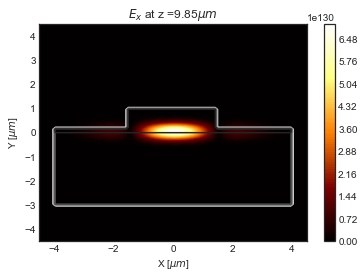

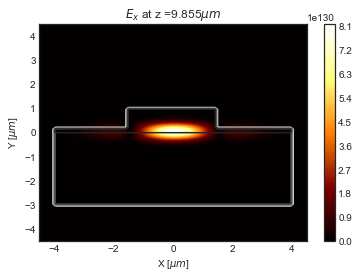

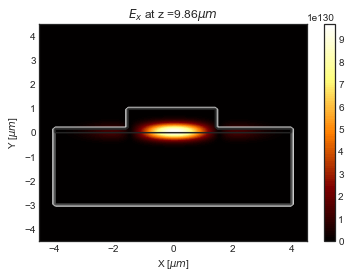

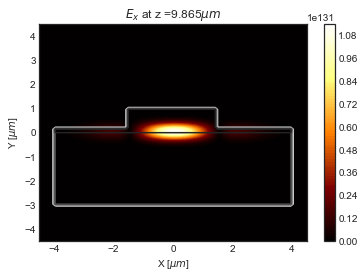

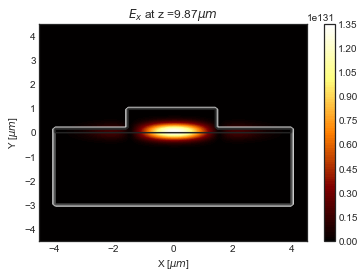

In [42]:
j = int(0)
for i in range(int(NZ)):
    E.ADI_BPM_solver(0,n)
    
    j += 1
    if j ==1:
        waveguide.plot(LX,LY,'binary',True,False)
        nX = np.linspace(-LX/2,LX/2,NX)
        nY = np.linspace(-LY/2,LY/2,NY)
        plt.contourf(nX,nY,np.abs(E.data2d[0]),100,cmap = "afmhot")
        plt.colorbar()
        plt.title("$E_x$ at z ="+ str(LZ* i /NZ ) + "$\mu m $")
        plt.show()
        j=0

In [ ]:
plt.style.use('seaborn-white')

waveguide.plot(LX,LY,'binary',True,False)
nX = np.linspace(-LX/2,LX/2,NX)
nY = np.linspace(-LY/2,LY/2,NY)
plt.contour(nX,nY,np.abs(E.data2d[7]),50,cmap = "gist_rainbow")
plt.colorbar()
plt.xlabel("X [$\mu m$]")
plt.ylabel("Y [$\mu m$]")

plt.title("$E_x$ Final Field")
plt.show()